<a href="https://colab.research.google.com/github/SanBartolome/IA-diploma-course-2021/blob/main/DAVA_SIFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Desarrollo de Aplicaciones con Visión Artificial: SIFT

En este notebook aprenderás a implementar la extracción de características locales de una imagen y como podemos encontrar y asociar objetos.

In [1]:
!wget https://github.com/diplomado-ia-pucp/dava/raw/main/catedral1.jpg
!wget https://github.com/diplomado-ia-pucp/dava/raw/main/catedral2.jpg

--2021-12-10 02:58:07--  https://github.com/diplomado-ia-pucp/dava/raw/main/catedral1.jpg
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/diplomado-ia-pucp/dava/main/catedral1.jpg [following]
--2021-12-10 02:58:07--  https://raw.githubusercontent.com/diplomado-ia-pucp/dava/main/catedral1.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 158486 (155K) [image/jpeg]
Saving to: ‘catedral1.jpg’

catedral1.jpg       100%[===================>] 154.77K  --.-KB/s    in 0.02s   

2021-12-10 02:58:07 (6.15 MB/s) - ‘catedral1.jpg’ saved [158486/158486]

--2021-12-10 02:58:07--  https://github.com/diplomad

In [2]:
# to run in google colab
import sys
if 'google.colab' in sys.modules:
    import subprocess
    subprocess.call("pip install -U opencv-python".split())
    subprocess.call("pip install -U plotly".split())

In [3]:
import plotly
import plotly.express as px 
import numpy as np
import cv2

print(plotly.__version__)
print(cv2.__version__)

5.4.0
4.5.4


### Keypoints detection

detected keypoints: 2398



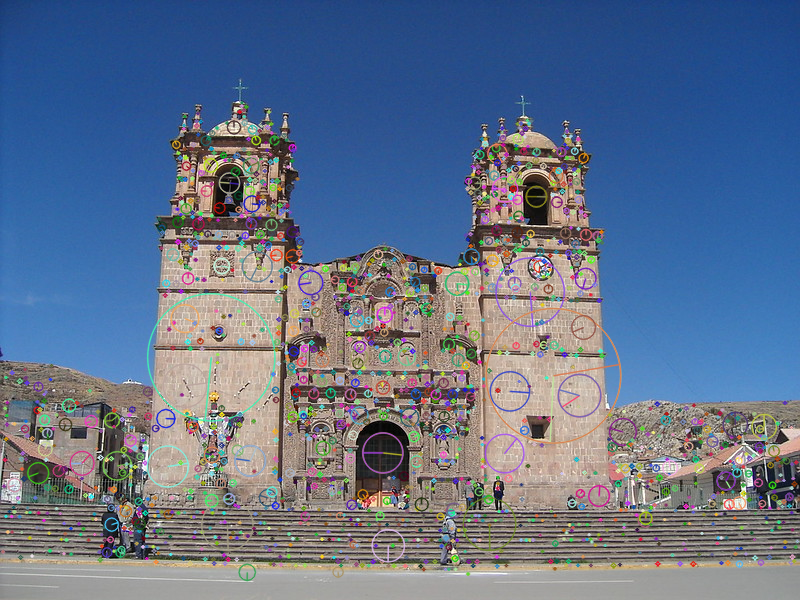

In [4]:
img = cv2.imread('catedral1.jpg')
img = img[:,:,::-1]

sift = cv2.SIFT_create()
kps = sift.detect(img)
test = cv2.drawKeypoints(img, kps, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

print('detected keypoints:', len(kps))

px.imshow(test).show()

### Keypoints matching

Los puntos de interés se computan usando las diferencias de Gaussianos en escalas pequeñas. Se podría decir que son puntos con características distintivas y que permiten encontrar correspondencias. Veamos ahora como se encuentran puntos correspondientes de dos imágenes en diferentes puntos de vista

In [5]:
img1 = cv2.imread('catedral1.jpg',0)
img2 = cv2.imread('catedral2.jpg',0)

px.imshow(img1, color_continuous_scale='gray').show()
px.imshow(img2, color_continuous_scale='gray').show()


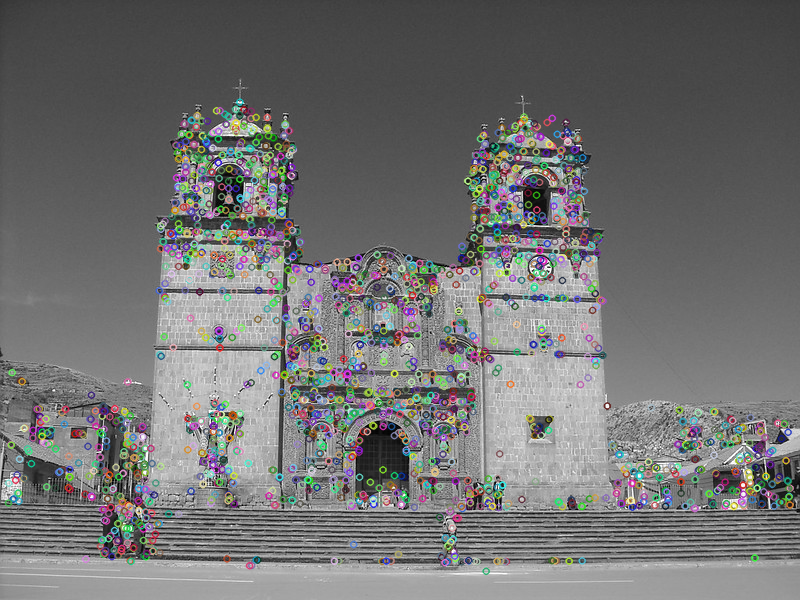


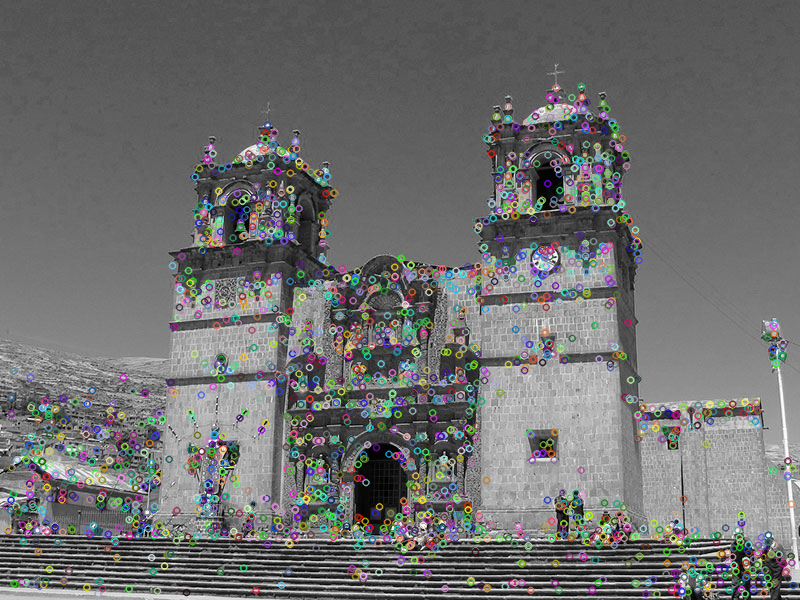

In [6]:
# Computando Características: kp1 => lista de keypoints, desc => descriptor
kaze = cv2.KAZE_create()

kp1, desc1 = kaze.detectAndCompute(img1,None)
img1_kps = cv2.drawKeypoints(img1,kp1,None)

kp2, desc2 = kaze.detectAndCompute(img2,None)
img2_kps = cv2.drawKeypoints(img2,kp2,None)


px.imshow(img1_kps, color_continuous_scale='gray', title=f'# kps: {len(kp1)}, descriptors: {desc1.shape}').show()
px.imshow(img2_kps, color_continuous_scale='gray', title=f'# kps: {len(kp2)}, descriptors: {desc2.shape}').show()


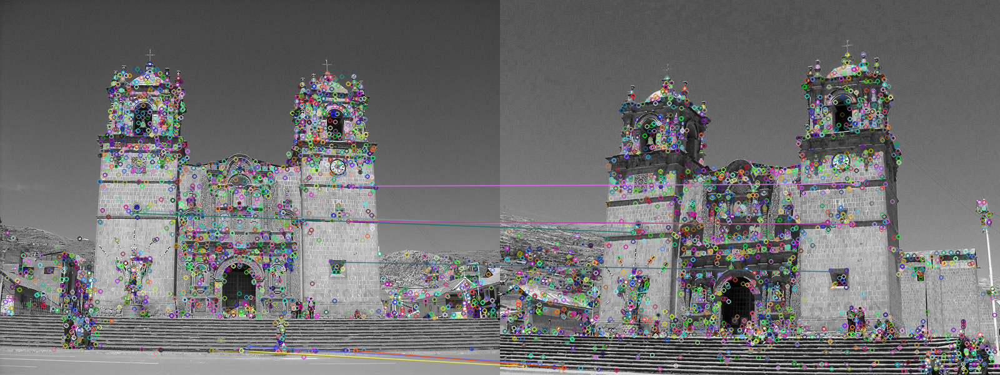

In [7]:
# Matching Keypoints usando BLT:
# create BFMatcher object
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

# Match descriptors
matches = bf.match(desc1,desc2)

# Sort them in the order of their distance
matches = sorted(matches, key = lambda x:x.distance)

# Draw first 10 matches.
img_match = cv2.drawMatches(img1,kp1,img2,kp2,matches[:10],None)

px.imshow(img_match).show()

### Image blending

In [8]:
points1 = np.zeros((len(matches),2), dtype = np.float32)
points2 = np.zeros((len(matches),2), dtype = np.float32)

for i,match in enumerate(matches):
    points1[i,:] = kp1[match.queryIdx].pt
    points2[i,:] = kp2[match.trainIdx].pt

# Find homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)
print(h)

imgRes = cv2.warpPerspective(img2, h, (img1.shape[1] + img2.shape[1], img2.shape[0]))

px.imshow(imgRes, color_continuous_scale='gray').show()

# Realizamos el image blending
imgRes[0:img1.shape[0],0:img1.shape[1]] = 0.5*imgRes[0:img1.shape[0],0:img1.shape[1]] + 0.5*img1

px.imshow(imgRes, color_continuous_scale='gray').show()

[[ 1.25065041e+00  7.66984003e-02 -6.38920961e+01]
 [ 2.01653830e-01  1.12110185e+00 -8.56919335e+01]
 [ 3.18807072e-04  7.55095395e-05  1.00000000e+00]]


### Ejercicio

Realizar la extracción de características de un logo de una marca conocida y realizar el matching sobre otra imagen que contenga el logo.

In [9]:
!wget https://tentulogo.com/wp-content/uploads/2017/06/cocacola-logo.jpg
!wget https://soy.marketing/wp-content/uploads/2020/11/1-25.jpg

--2021-12-10 02:58:47--  https://tentulogo.com/wp-content/uploads/2017/06/cocacola-logo.jpg
Resolving tentulogo.com (tentulogo.com)... 143.198.133.96
Connecting to tentulogo.com (tentulogo.com)|143.198.133.96|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 79824 (78K) [image/jpeg]
Saving to: ‘cocacola-logo.jpg’

cocacola-logo.jpg   100%[===================>]  77.95K  --.-KB/s    in 0.07s   

2021-12-10 02:58:47 (1.06 MB/s) - ‘cocacola-logo.jpg’ saved [79824/79824]

--2021-12-10 02:58:47--  https://soy.marketing/wp-content/uploads/2020/11/1-25.jpg
Resolving soy.marketing (soy.marketing)... 172.67.133.105, 104.21.13.231, 2606:4700:3035::ac43:8569, ...
Connecting to soy.marketing (soy.marketing)|172.67.133.105|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 55498 (54K) [image/jpeg]
Saving to: ‘1-25.jpg’

1-25.jpg            100%[===================>]  54.20K  --.-KB/s    in 0.001s  

2021-12-10 02:58:48 (89.2 MB/s) - ‘1-25.jpg’ saved [55

In [10]:
img1 = cv2.imread('cocacola-logo.jpg',0)
img2 = cv2.imread('1-25.jpg',0)

px.imshow(img1, color_continuous_scale='gray').show()
px.imshow(img2, color_continuous_scale='gray').show()


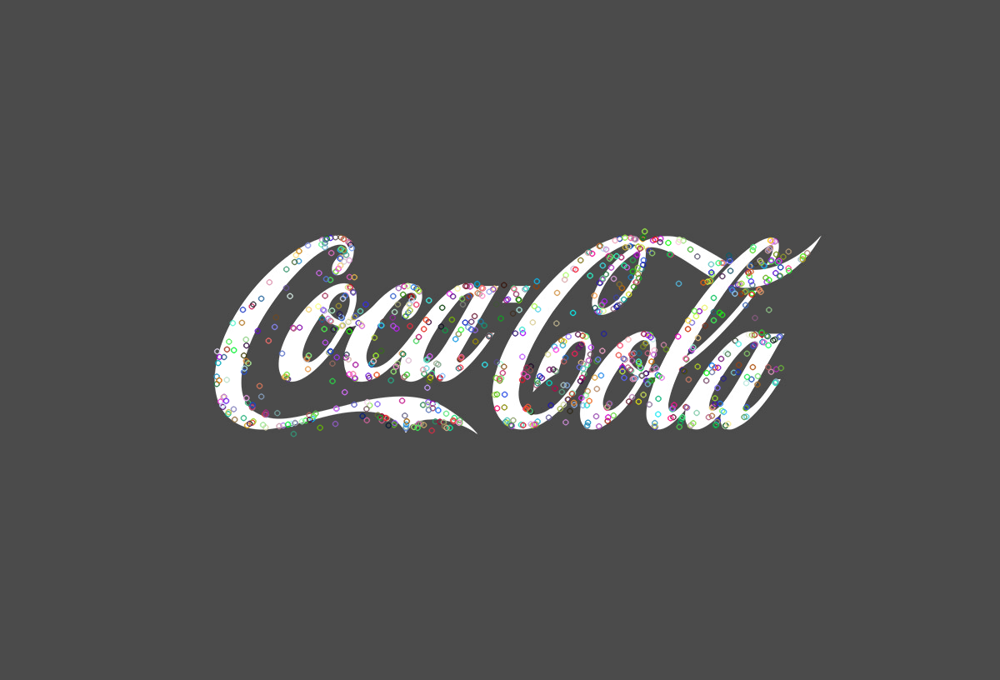


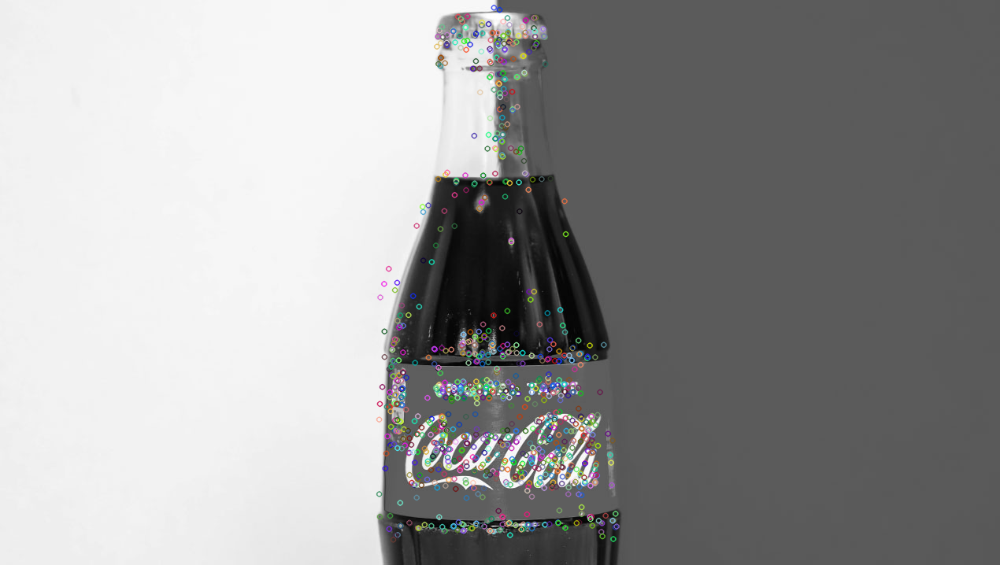

In [11]:
# Computando Características: kp1 => lista de keypoints, desc => descriptor
kaze = cv2.KAZE_create()

kp1, desc1 = kaze.detectAndCompute(img1,None)
img1_kps = cv2.drawKeypoints(img1,kp1,None)

kp2, desc2 = kaze.detectAndCompute(img2,None)
img2_kps = cv2.drawKeypoints(img2,kp2,None)


px.imshow(img1_kps, color_continuous_scale='gray', title=f'# kps: {len(kp1)}, descriptors: {desc1.shape}').show()
px.imshow(img2_kps, color_continuous_scale='gray', title=f'# kps: {len(kp2)}, descriptors: {desc2.shape}').show()


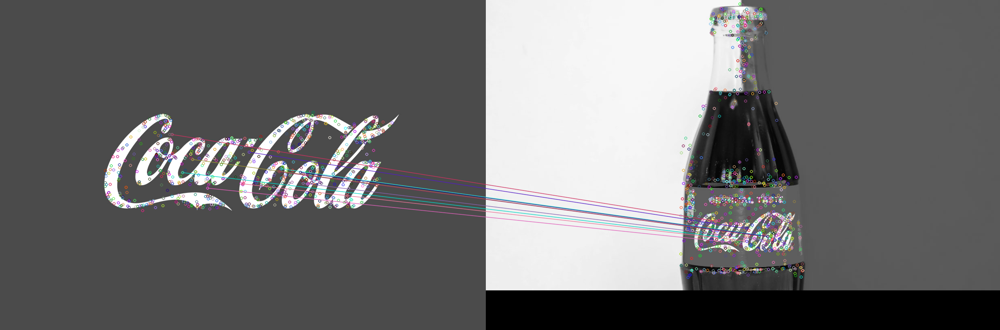

In [12]:
# Matching Keypoints usando BLT:
# create BFMatcher object
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

# Match descriptors
matches = bf.match(desc1,desc2)

# Sort them in the order of their distance
matches = sorted(matches, key = lambda x:x.distance)

# Draw first 10 matches.
img_match = cv2.drawMatches(img1,kp1,img2,kp2,matches[:10],None)

px.imshow(img_match).show()

### Panorama Stitching

Ejemplo tomado de [Image Stitching Using OpenCV](https://towardsdatascience.com/image-stitching-using-opencv-817779c86a83).

In [13]:
!wget https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/left.jpg
!wget https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/right.jpg

--2021-12-10 02:58:52--  https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/left.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 166595 (163K) [image/jpeg]
Saving to: ‘left.jpg’

left.jpg            100%[===================>] 162.69K  --.-KB/s    in 0.03s   

2021-12-10 02:58:52 (6.31 MB/s) - ‘left.jpg’ saved [166595/166595]

--2021-12-10 02:58:52--  https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/right.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 165300 (161K) [i


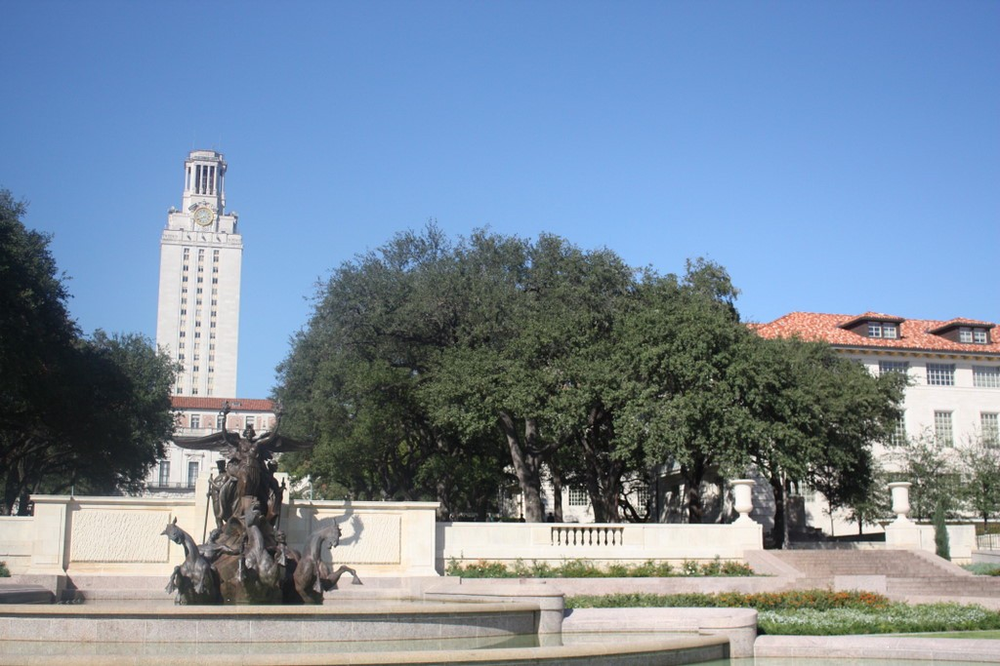


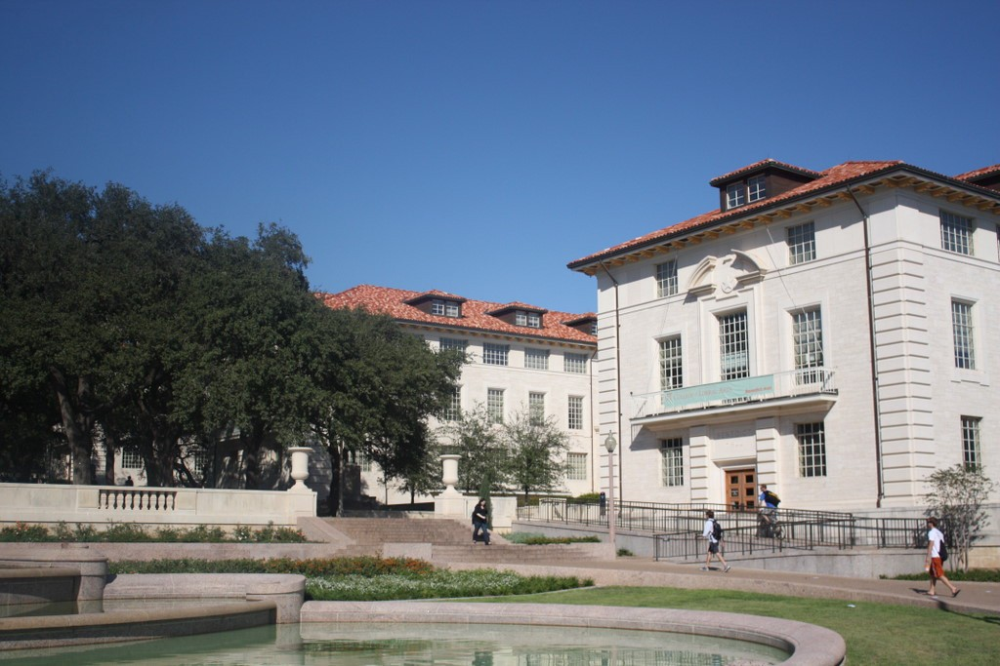

In [14]:
img_left = cv2.imread('left.jpg')
img_left = img_left[:,:,::-1]
img_right = cv2.imread('right.jpg')
img_right = img_right[:,:,::-1]

px.imshow(img_left).show()
px.imshow(img_right).show()


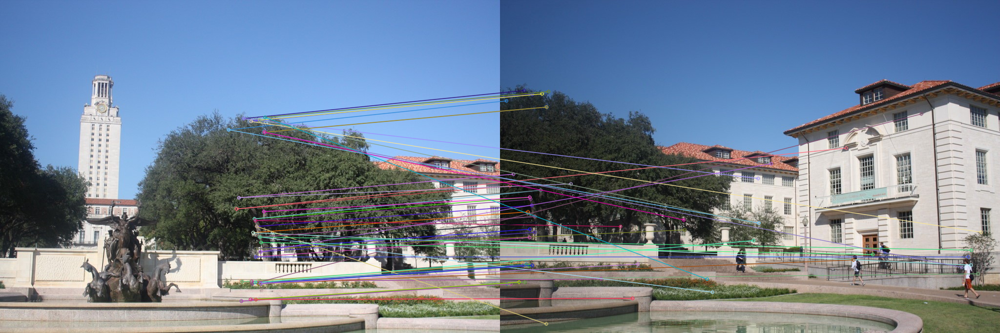

In [15]:
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
kps_left, des_left = sift.detectAndCompute(img_left,None)
kps_right, des_right = sift.detectAndCompute(img_right,None)

# BFMatcher with default params
bf = cv2.BFMatcher()
matches = bf.knnMatch(des_left,des_right,k=2)

# Apply ratio test
good = []
for m in matches:
    if m[0].distance < 0.5*m[1].distance:         
        good.append(m)
matches = np.asarray(good)

# print(matches[:,0])

# show only 30 matches
im_matches = cv2.drawMatchesKnn(img_left, kps_left, img_right, kps_right,
                                good[0:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

px.imshow(im_matches, title='keypoints matches').show()

712
(712, 1, 2)
[[ 7.63614227e-01  2.57330051e-02  4.48845289e+02]
 [-1.34348281e-01  9.02321383e-01  7.77741113e+01]
 [-2.08308897e-04 -4.45480941e-05  1.00000000e+00]]



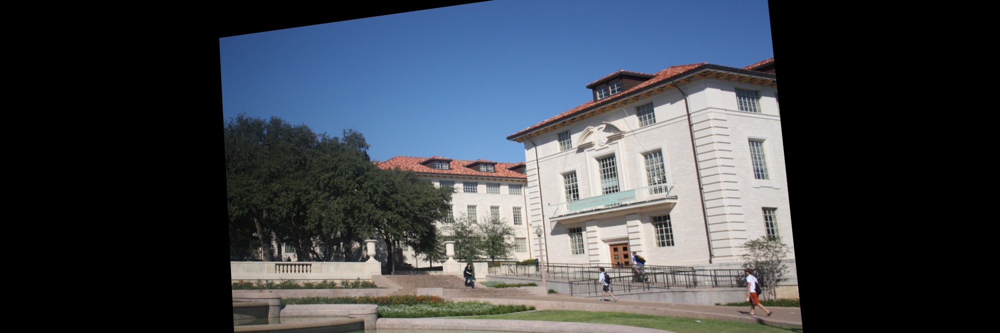


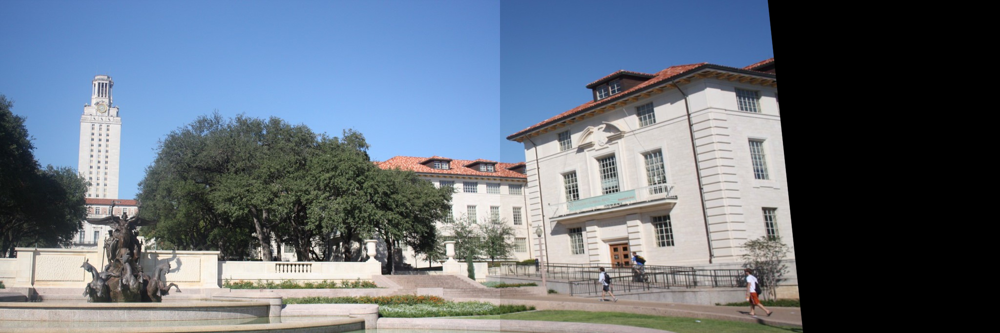

In [16]:
#print(kps_right[0].pt)
print(len(matches[:,0]))

src = np.float32([ kps_right[m.trainIdx].pt for m in matches[:,0] ]).reshape(-1,1,2)
dst = np.float32([ kps_left[m.queryIdx].pt for m in matches[:,0] ]).reshape(-1,1,2)

print(src.shape)

H, masked = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)
print(H)
   
dst = cv2.warpPerspective(img_right,H,(img_left.shape[1] + img_right.shape[1], img_left.shape[0]))     	

px.imshow(dst, title='Warped Image').show()

dst[0:img_left.shape[0], 0:img_left.shape[1]] = img_left

px.imshow(dst, title='Panorama Stitching').show()

### Tarea

Usar características locales para componer la imagen panorámica a partir de las imagenes tomadas en la secuencia que sigue:

In [17]:
!wget https://github.com/diplomado-ia-pucp/dava/raw/main/stitching.zip
!unzip stitching.zip

--2021-12-10 02:58:56--  https://github.com/diplomado-ia-pucp/dava/raw/main/stitching.zip
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/diplomado-ia-pucp/dava/main/stitching.zip [following]
--2021-12-10 02:58:56--  https://raw.githubusercontent.com/diplomado-ia-pucp/dava/main/stitching.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1386943 (1.3M) [application/zip]
Saving to: ‘stitching.zip’

stitching.zip       100%[===================>]   1.32M  --.-KB/s    in 0.07s   

2021-12-10 02:58:57 (19.4 MB/s) - ‘stitching.zip’ saved [1386943/1386943]

Archive:  stitching.zip
  inflating: DSC_414


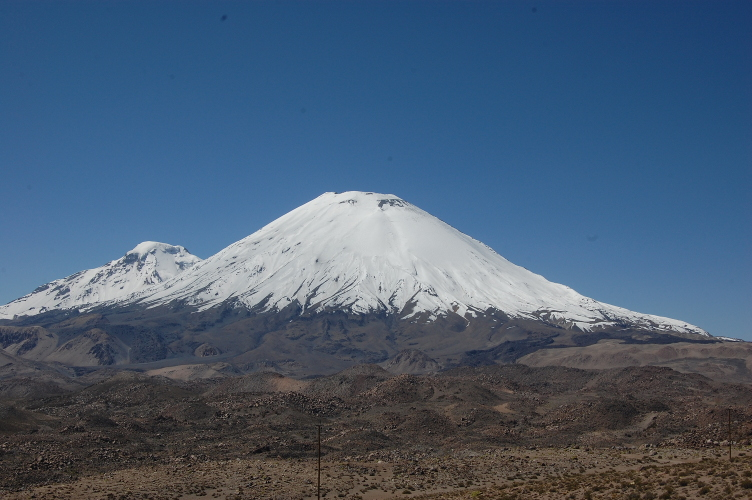


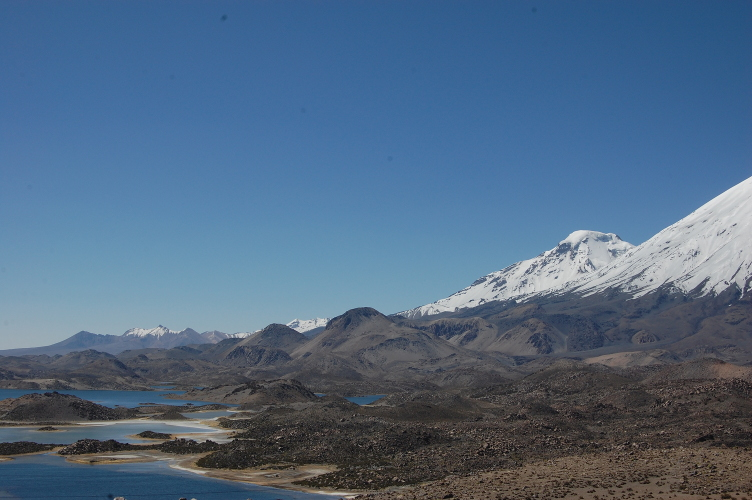


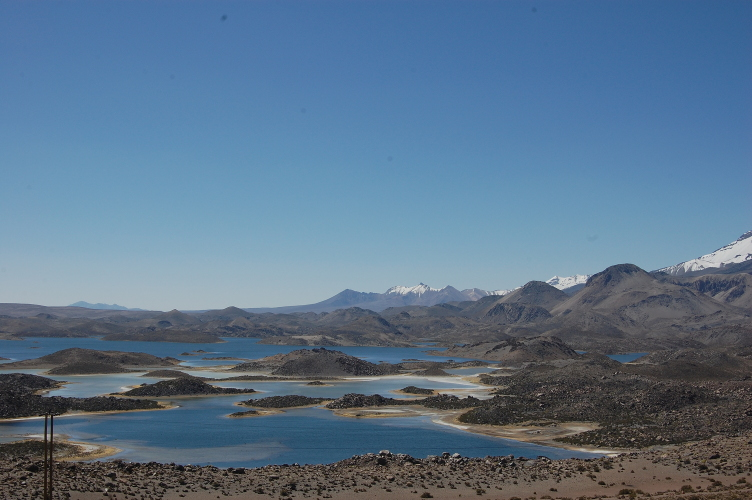


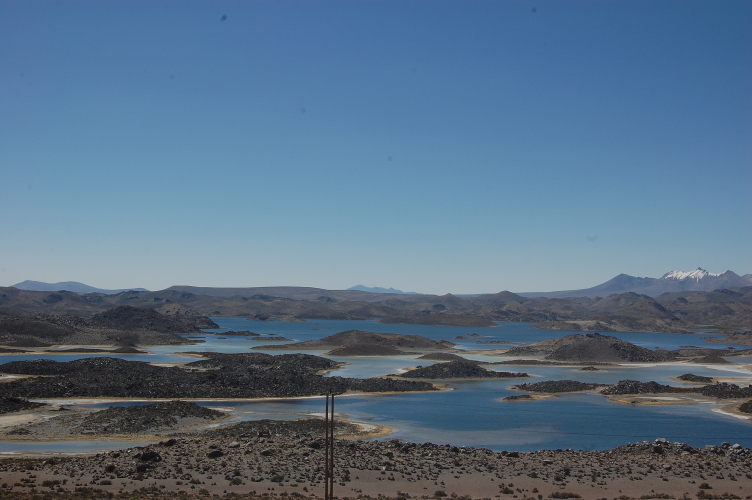


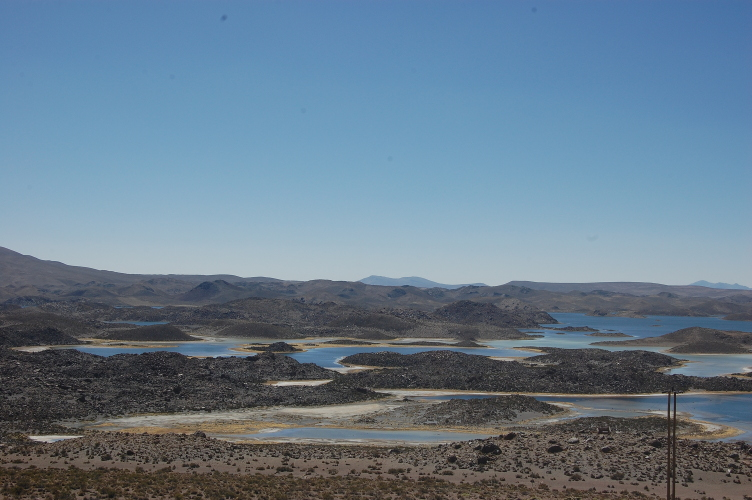


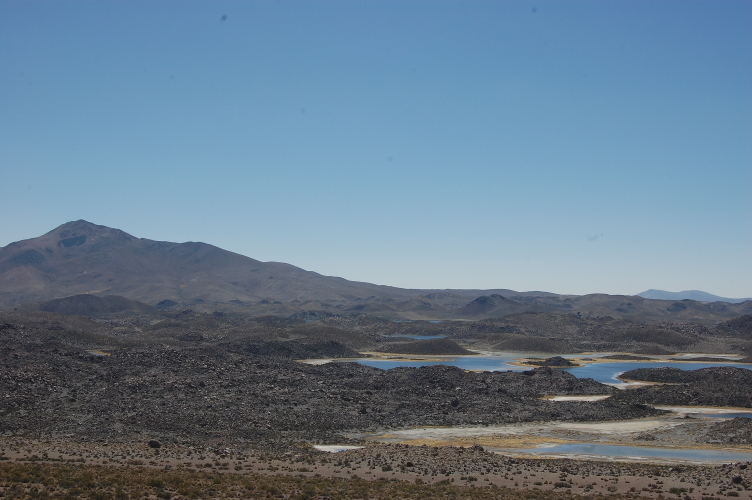


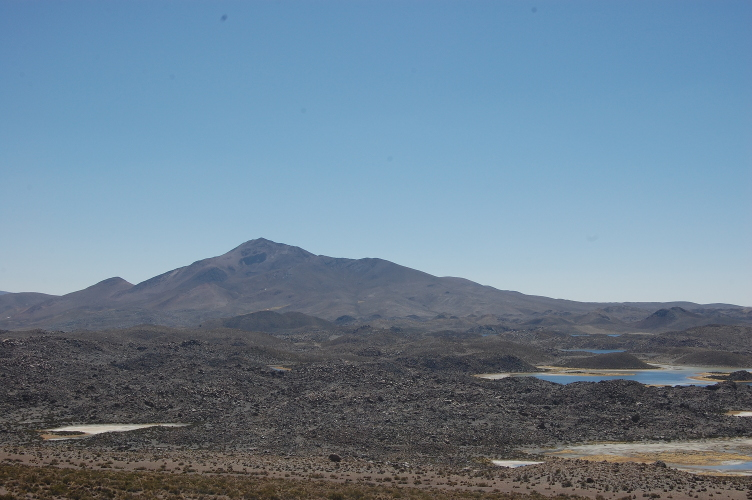

In [24]:
import glob 
images = [cv2.cvtColor(cv2.imread(f), cv2.COLOR_BGR2RGB) for f in sorted(glob.glob('DSC_41*.JPG'))]

for image in images:
    px.imshow(image).show()

In [52]:
stitcher = cv2.Stitcher.create()

In [53]:
(status, result) = stitcher.stitch(images)


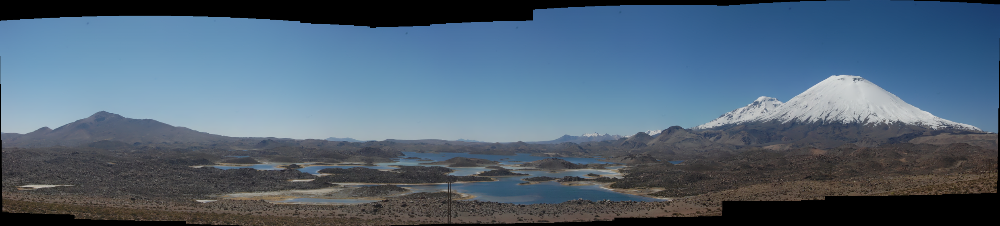

In [54]:
px.imshow(result).show()